# Advanced Lane Finding

## 0. Setup

### Imports

In [1]:
import glob
import os

import cv2
import matplotlib.pyplot as plt
import numpy as np

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

import image
from lane import Lane

# set this to an empty string ("") to display the outputted videos, otherwise the videos online will be shown
videos_basepath = ''#'https://jefflirion.github.io/udacity_car_nanodegree_project04/'

### Get a list of all the test images as `Lane` objects

In [2]:
test_images = glob.glob('../../Repos/CarND-Advanced-Lane-Lines/test_images/*.jpg')

lanes_list = []
for imgpath in test_images:
    lanes_list.append(Lane(imgpath=imgpath))

### Perspective transform constants

In [3]:
img_size = cv2.imread(test_images[0]).shape[1::-1]
offset_x = 300
offset_y = 0

src = np.float32([[595, 450], [688, 450], [1015, 660], [295, 660]])
src = np.float32([[595, 450], [685, 450], [1000, 660], [280, 660]])

dst = np.float32([[offset_x, offset_y], 
                  [img_size[0]-offset_x, offset_y],
                  [img_size[0]-offset_x, img_size[1]-offset_y],
                  [offset_x, img_size[1]-offset_y]])

# use cv2.getPerspectiveTransform() to get M and Minv, the transform matrix and inverse transform matrix
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst,src)

### Parameters for finding the lane lines

In [4]:
# window settings
window_width = 50 # width of the convolution windows --> must be even!
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin_naive = 50 # How much to slide left and right for searching
margin_prior = 50#25
minsum = 3

assert window_width % 2 == 0, '`window_width` must be even'

## 1. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

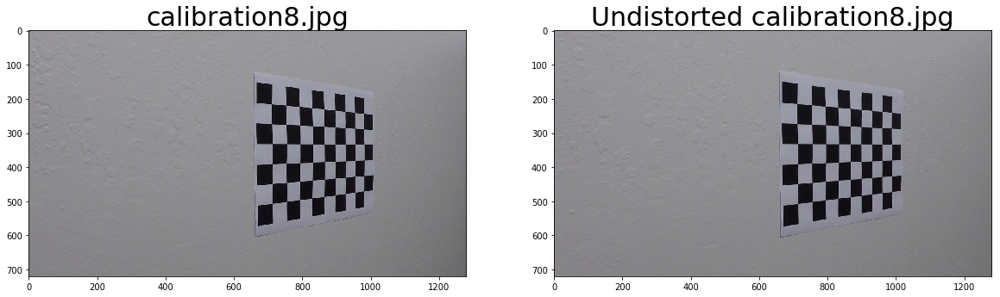

In [5]:
calibration_images = glob.glob('../../Repos/CarND-Advanced-Lane-Lines/camera_cal/*.jpg')
nx = 9
ny = 6

mtx, dist = image.calibrate_camera(calibration_images, nx, ny)

l = Lane(imgpath='../../Repos/CarND-Advanced-Lane-Lines/camera_cal/calibration8.jpg')
undistorted = l.get_undistorted(mtx, dist, outfile='../../Projects/Project_04/output_images/undistorted_calibration8.jpg')
image.show_images(l.img, 'calibration8.jpg', undistorted, 'Undistorted calibration8.jpg')

## 2. Apply a distortion correction to raw images.

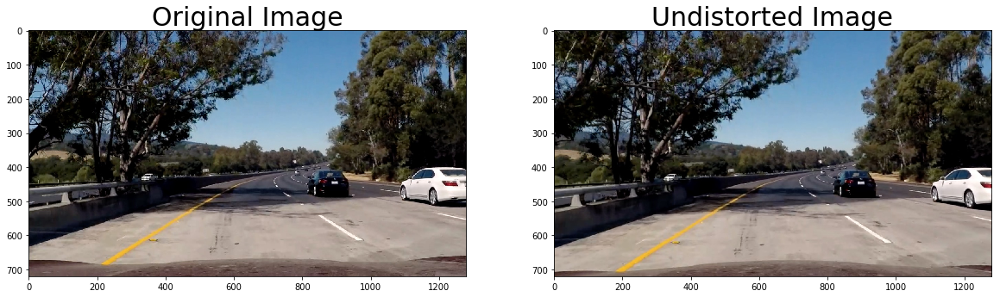

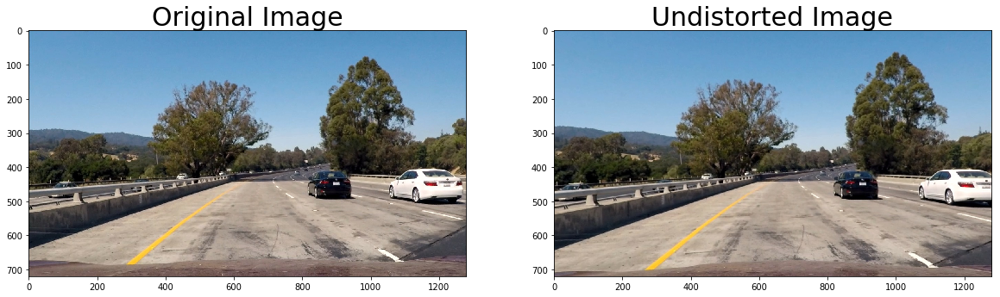

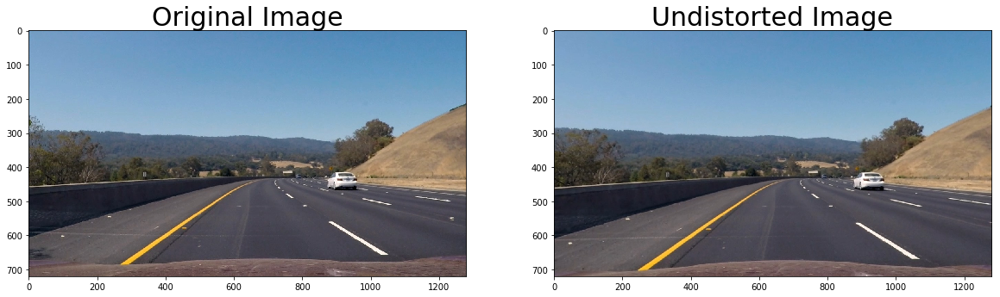

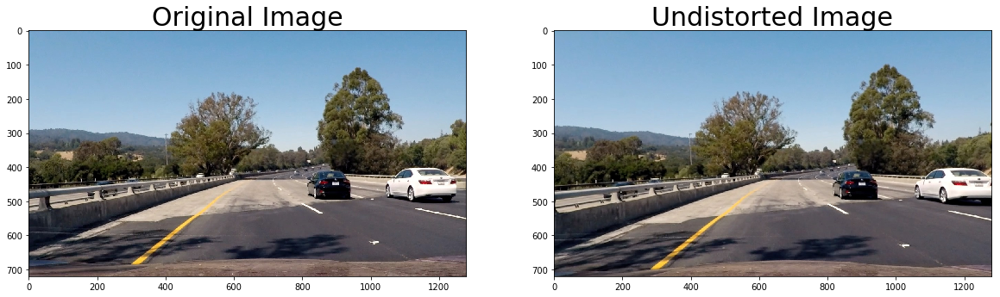

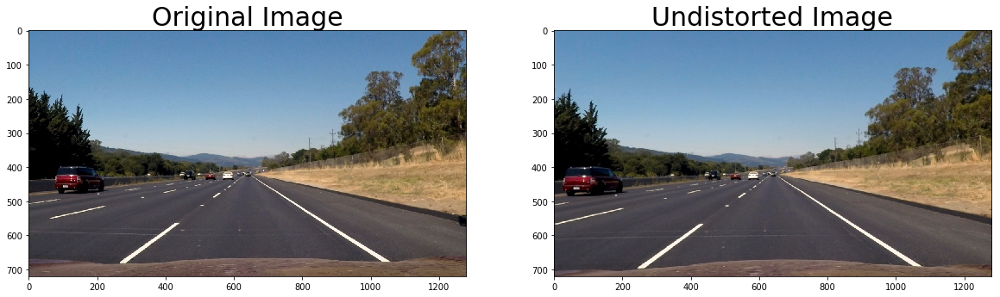

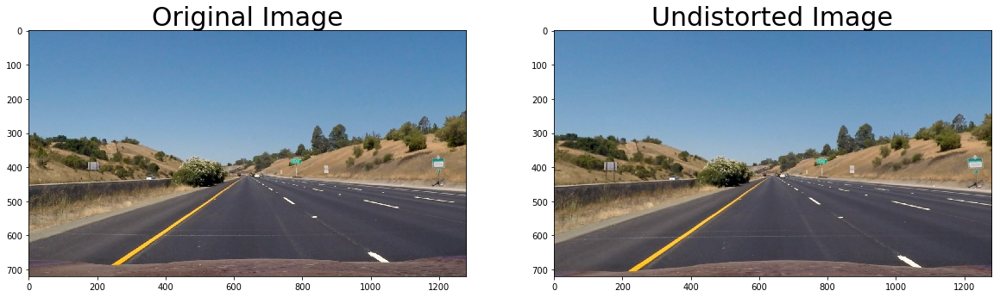

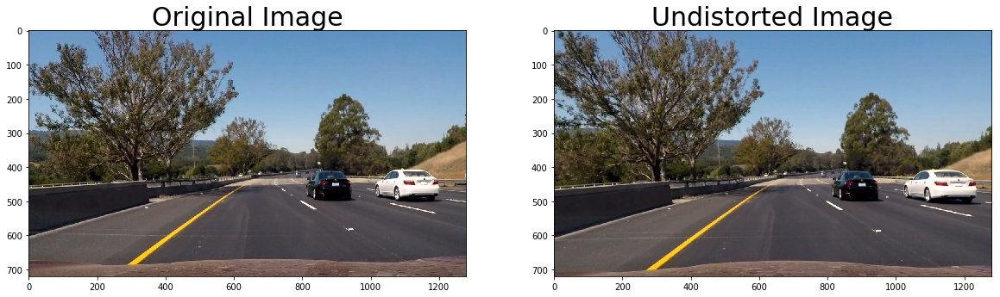

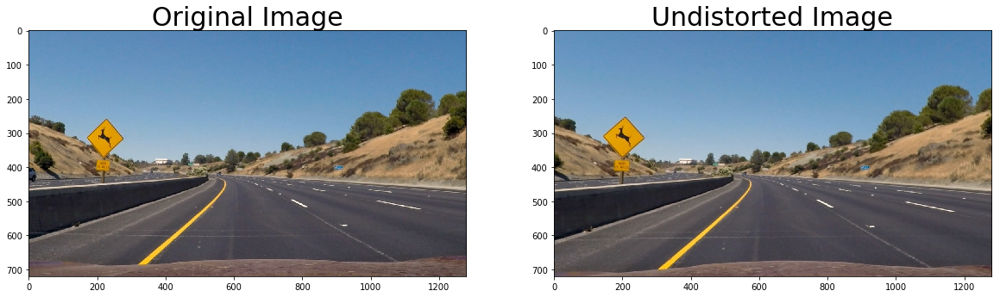

In [6]:
outfile = '../../Projects/Project_04/output_images/undistorted/undistorted_{0}'
for l in lanes_list:
    undistorted = l.get_undistorted(mtx, dist, outfile=outfile.format(os.path.basename(l.imgpath)))    
    image.show_images(l.img, 'Original Image', undistorted, 'Undistorted Image')

## 3. Use color transforms, gradients, etc., to create a thresholded binary image.

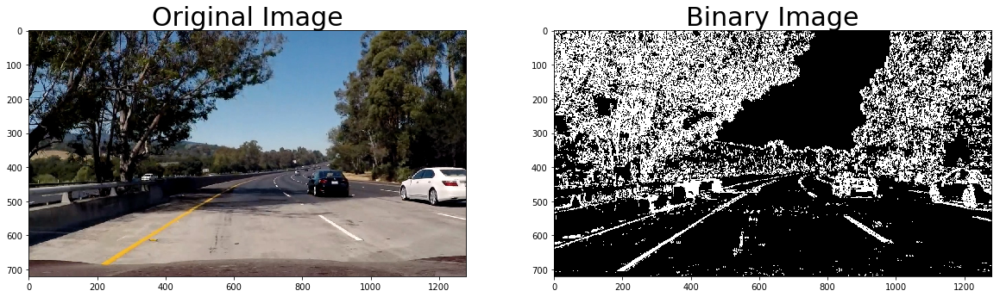

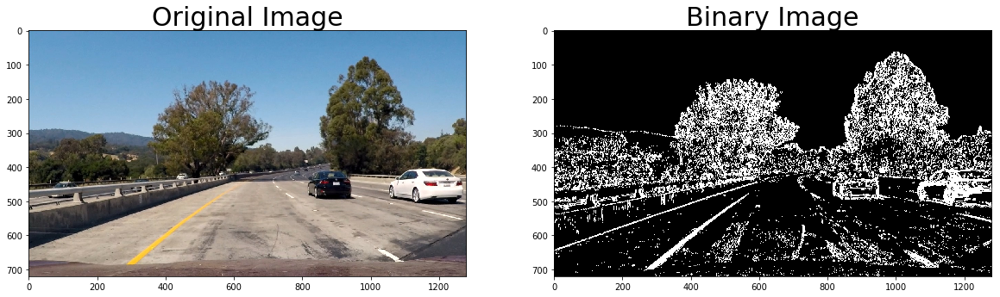

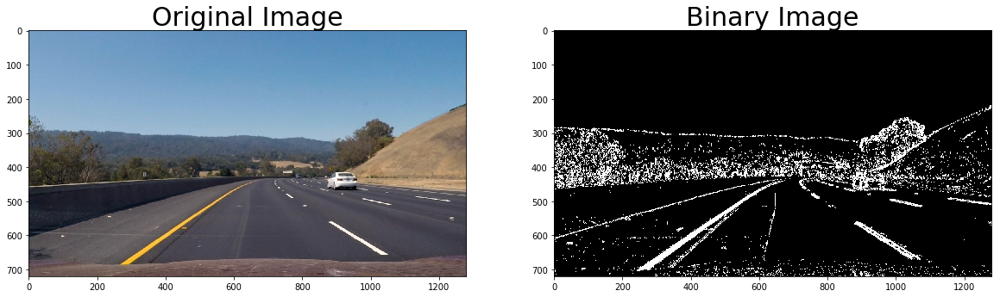

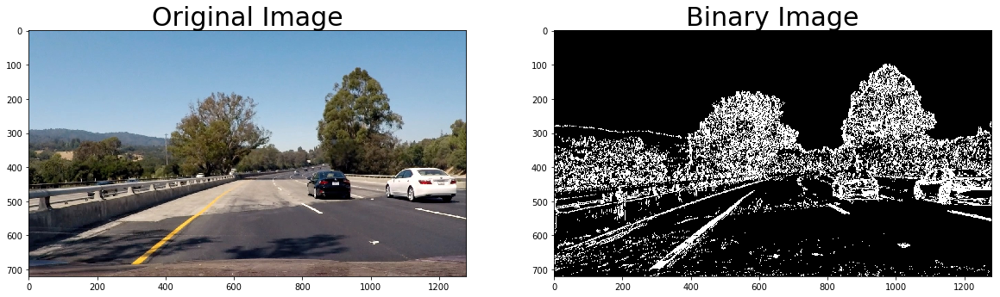

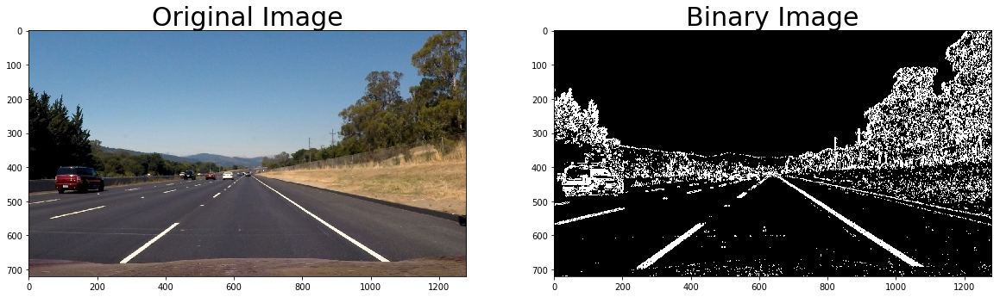

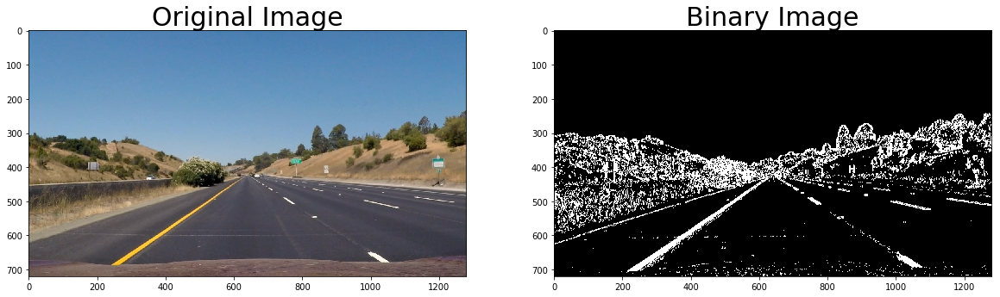

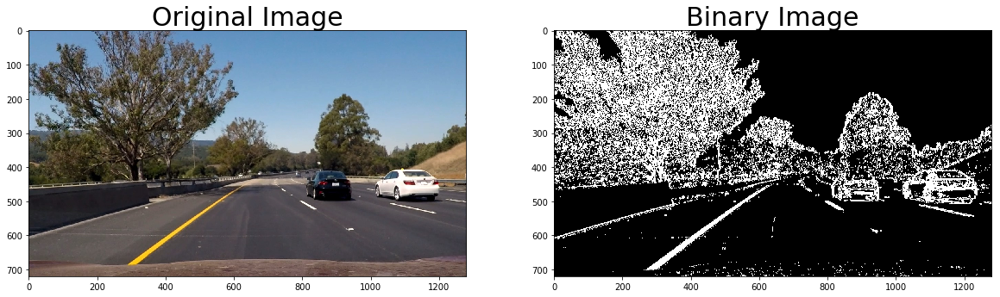

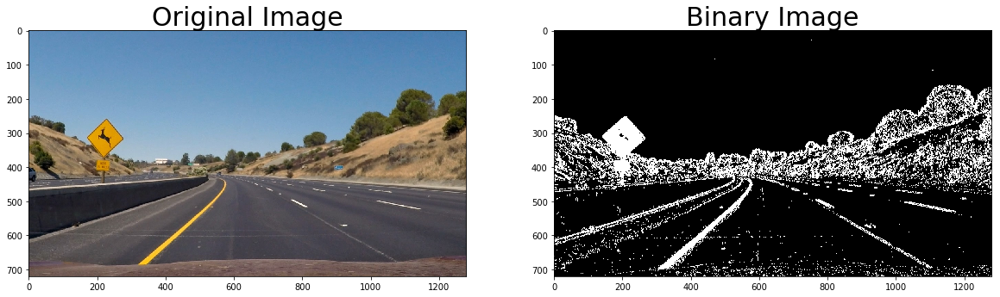

In [7]:
outfile = '../../Projects/Project_04/output_images/binary/binary_{0}'
for l in lanes_list:
    binary = l.get_binary(mtx, dist, outfile=outfile.format(os.path.basename(l.imgpath)))
    image.show_images(l.img, 'Original Image', binary*255, 'Binary Image')

## 4. Apply a perspective transform to rectify binary image ("birds-eye view").

### Display the perspective images

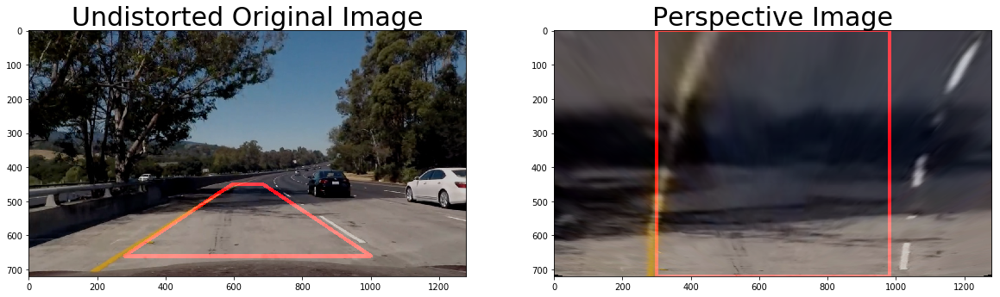

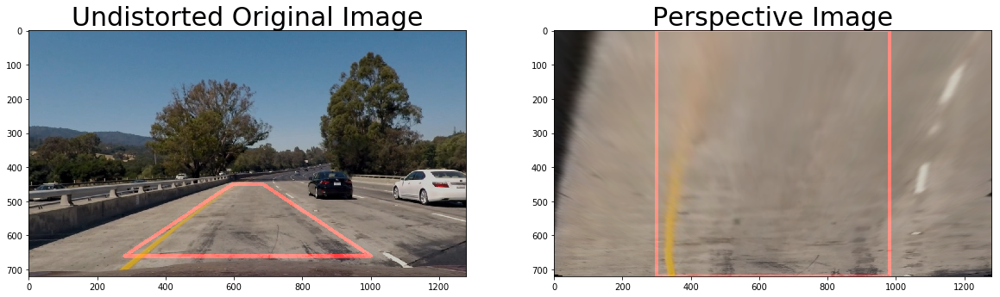

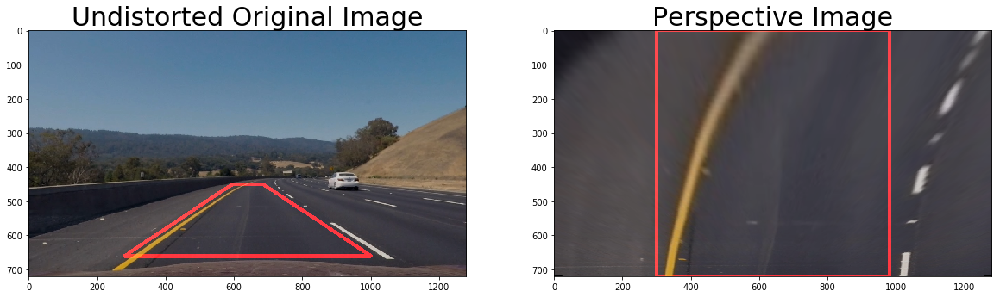

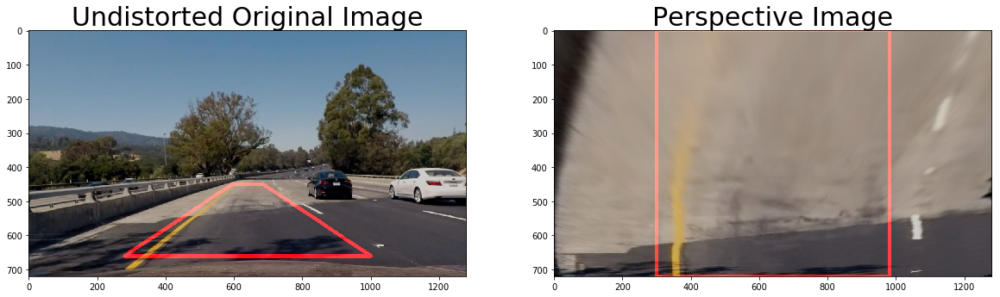

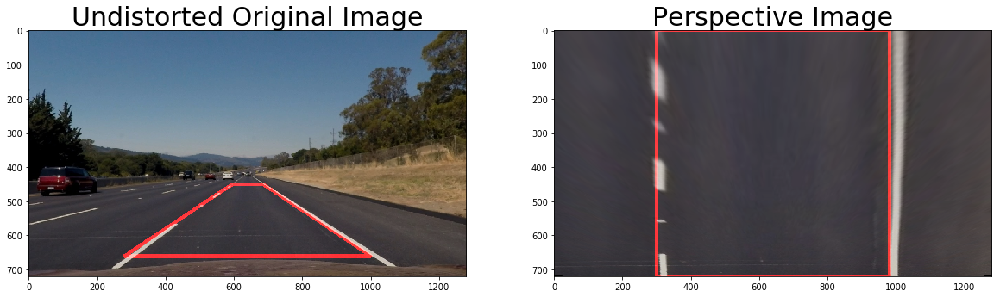

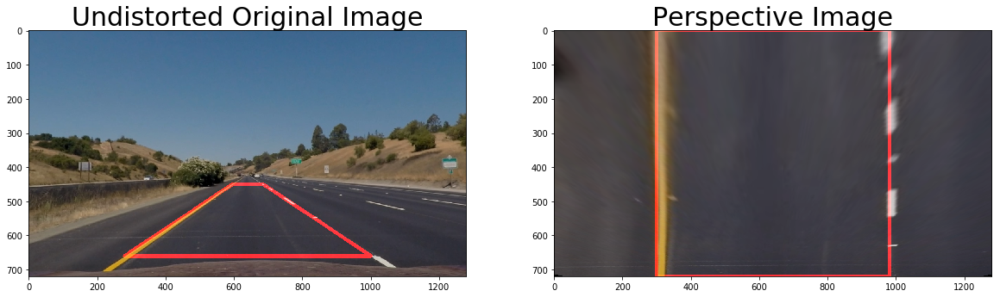

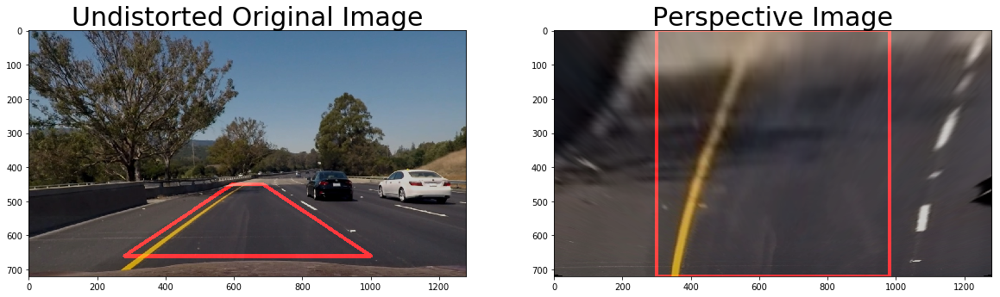

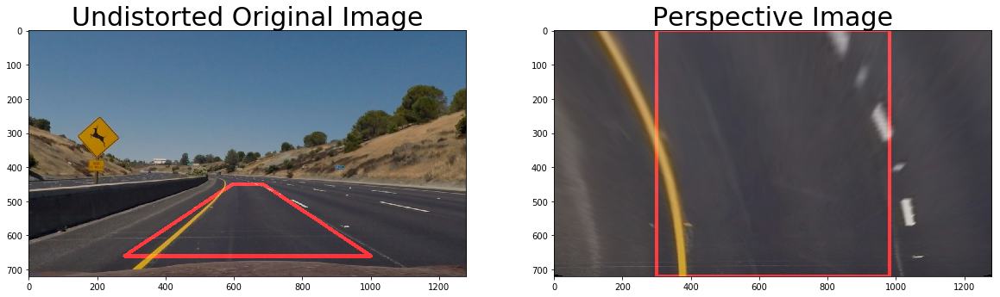

In [8]:
outfile = '../../Projects/Project_04/output_images/perspective/perspective_{0}'
for l in lanes_list:
    undistorted = l.get_undistorted(mtx, dist, src)
    perspective = l.get_perspective(mtx, dist, M, dst, outfile=outfile.format(os.path.basename(l.imgpath)))
    image.show_images(undistorted, 'Undistorted Original Image', perspective, 'Perspective Image')

### Display the binary perspective images

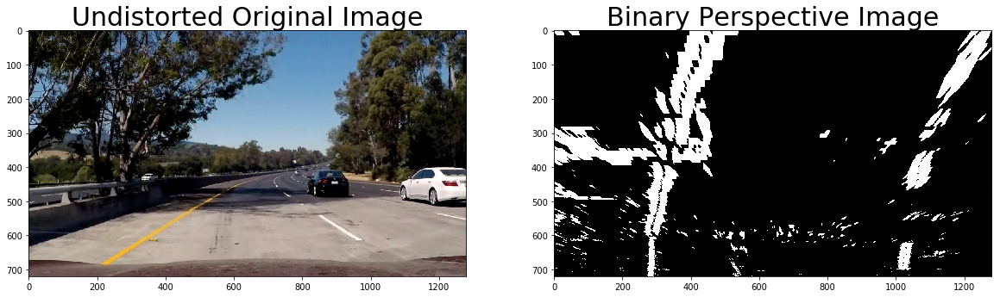

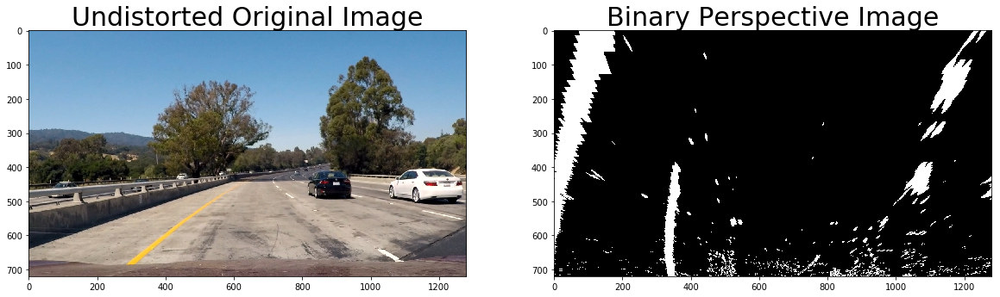

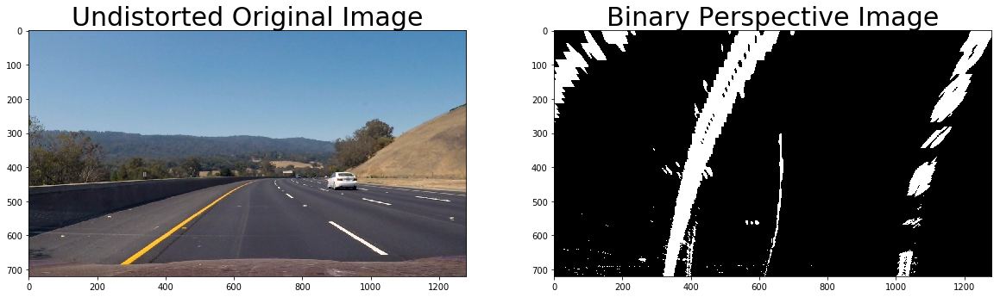

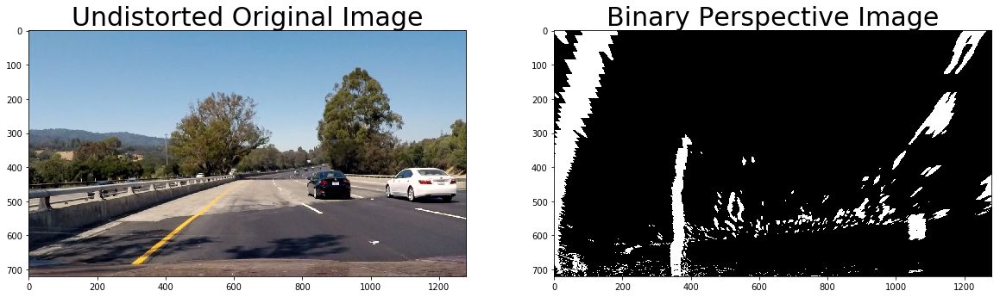

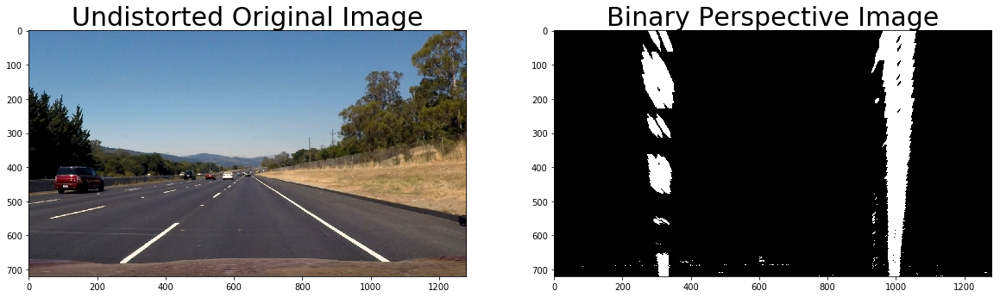

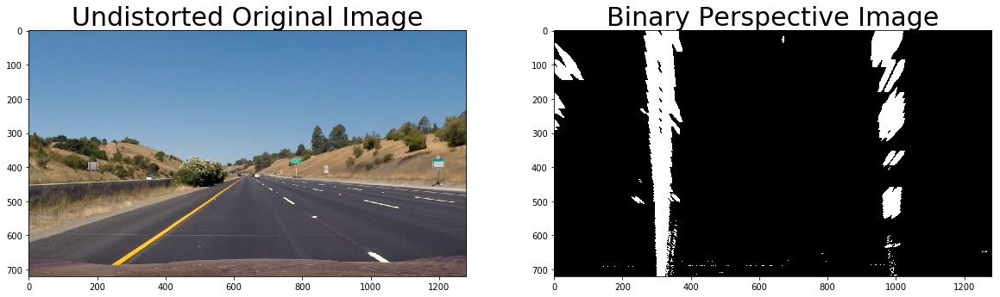

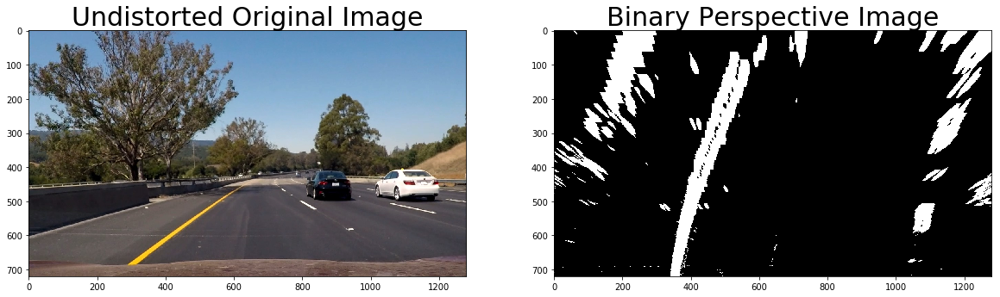

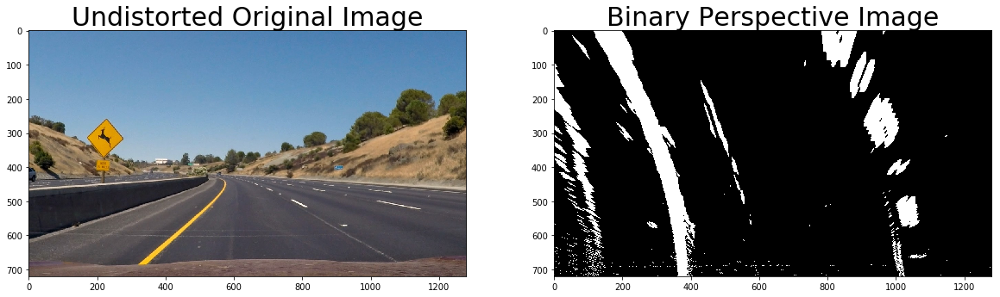

In [9]:
outfile = '../../Projects/Project_04/output_images/binary_perspective/binary_perspective_{0}'
for l in lanes_list:
    undistorted = l.get_undistorted(mtx, dist)
    binary_perspective = l.get_binary_perspective(mtx, dist, M, outfile=outfile.format(os.path.basename(l.imgpath)))
    image.show_images(l.img, 'Undistorted Original Image', binary_perspective*255, 'Binary Perspective Image')

## 5. Detect lane pixels and fit to find the lane boundary.

### Find the lane lines using moving windows

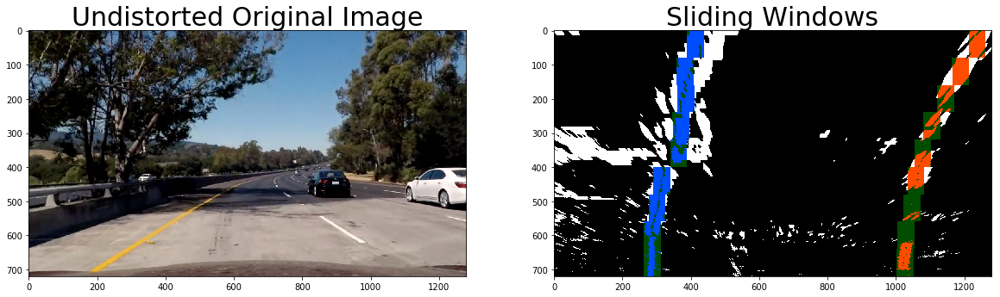

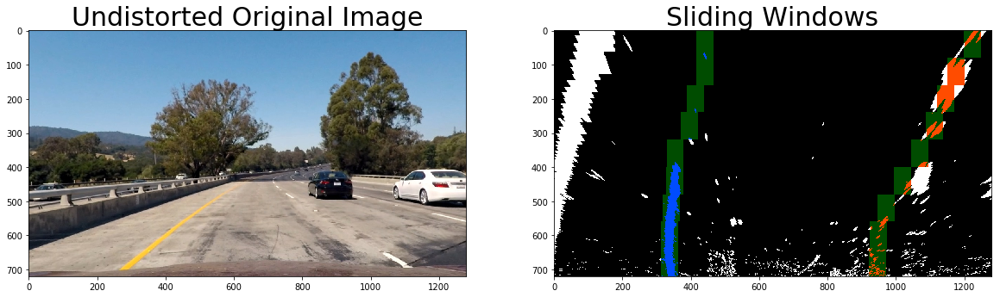

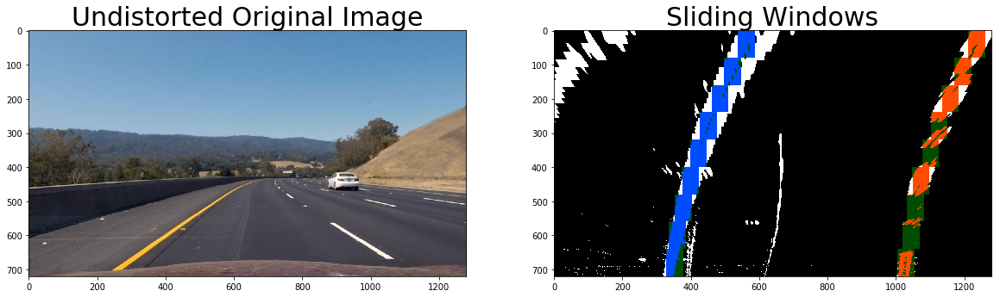

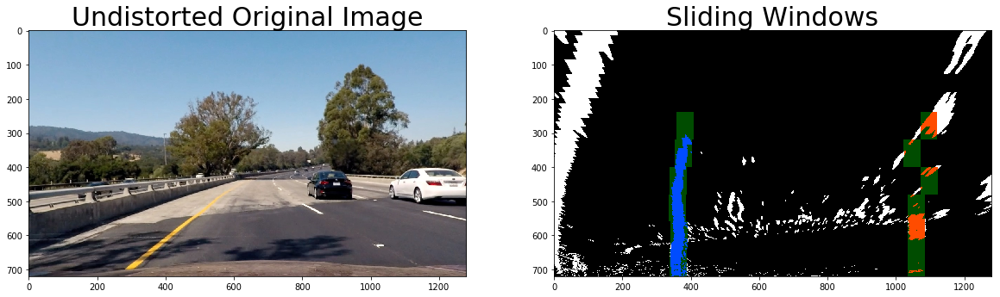

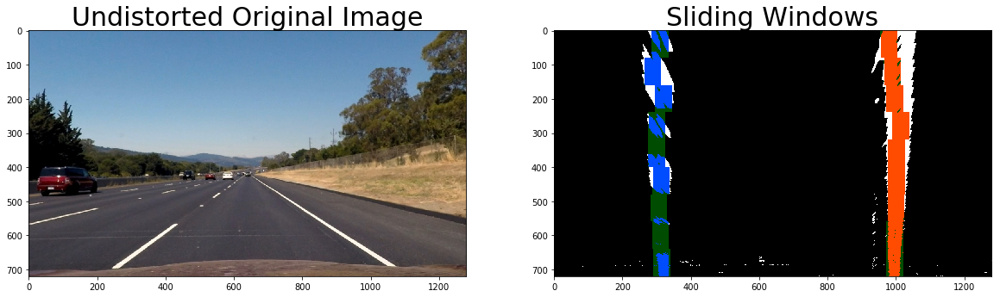

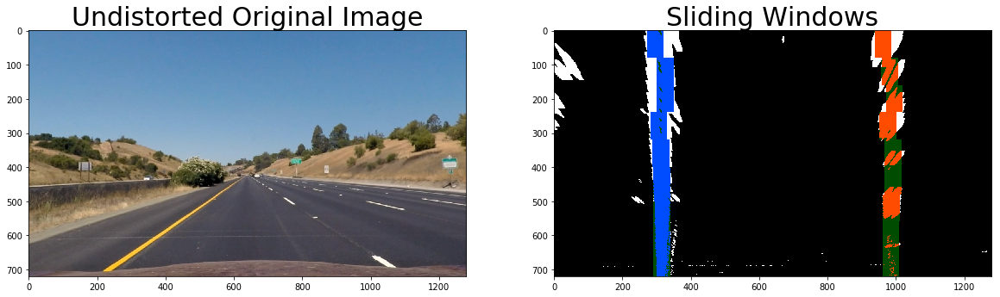

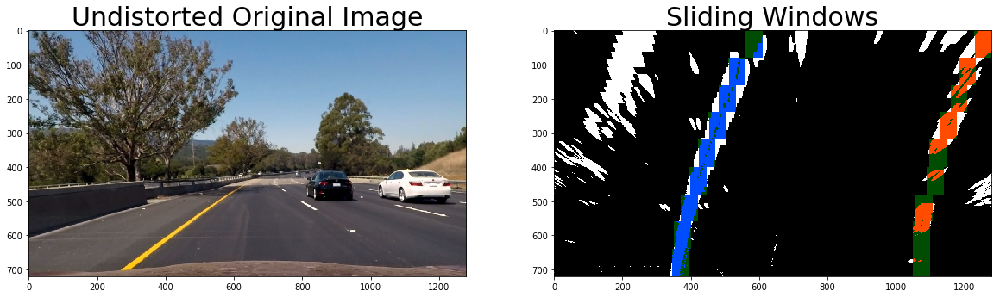

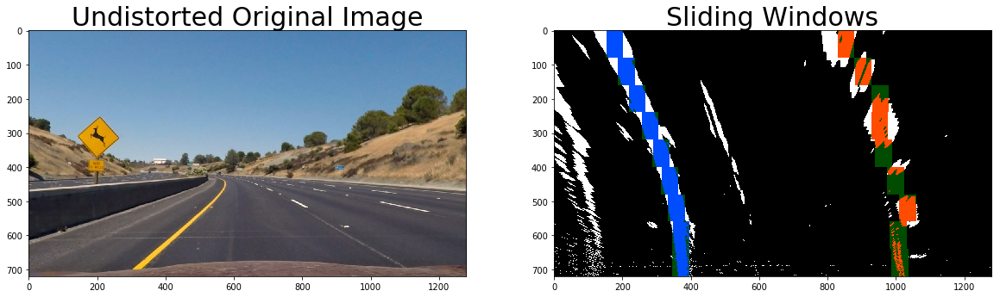

In [10]:
outfile = '../../Projects/Project_04/output_images/windows/windows_{0}'
for l in lanes_list:
    window_centroids = l.find_window_centroids(mtx, dist, M, window_width, window_height, margin_naive, minsum)
    l.plot_window_centroids(mtx, dist, M, window_centroids, window_width, window_height,
                            outfile=outfile.format(os.path.basename(l.imgpath)))

### Fit the lines and plot the results on the binary perspective images

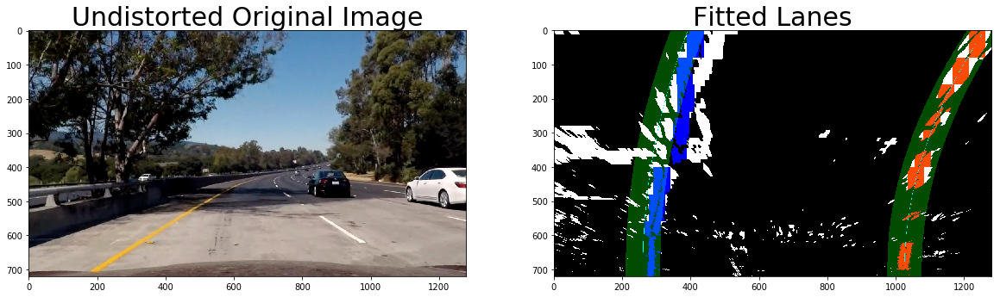

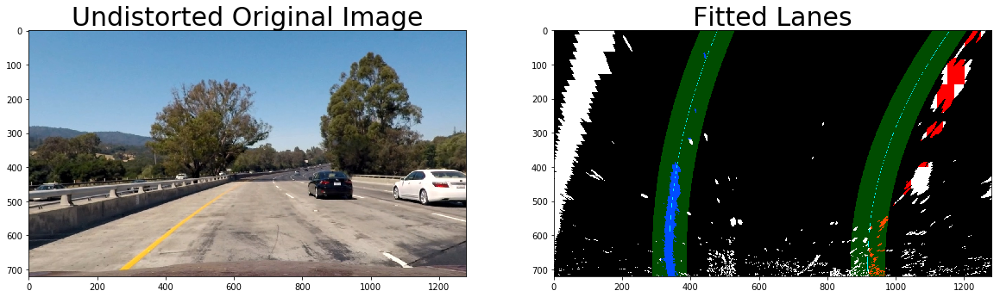

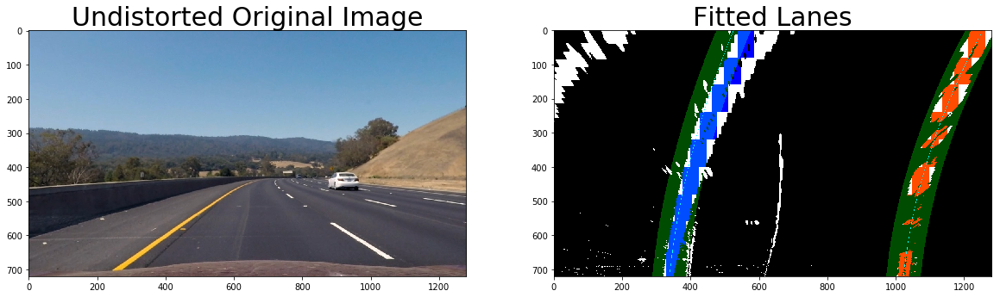

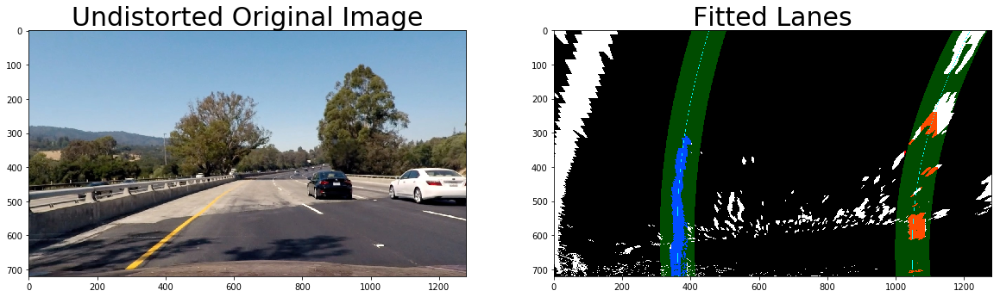

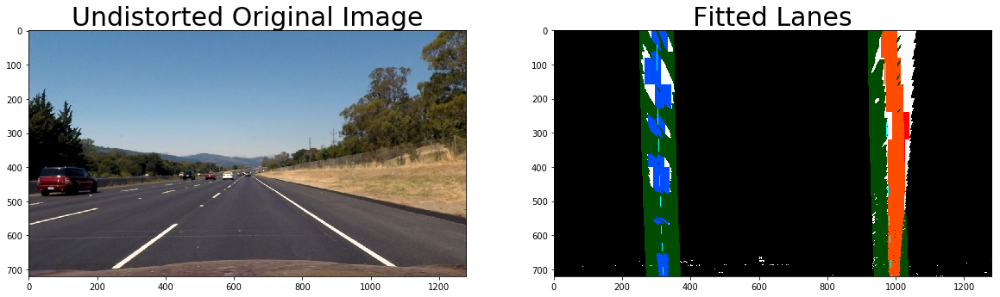

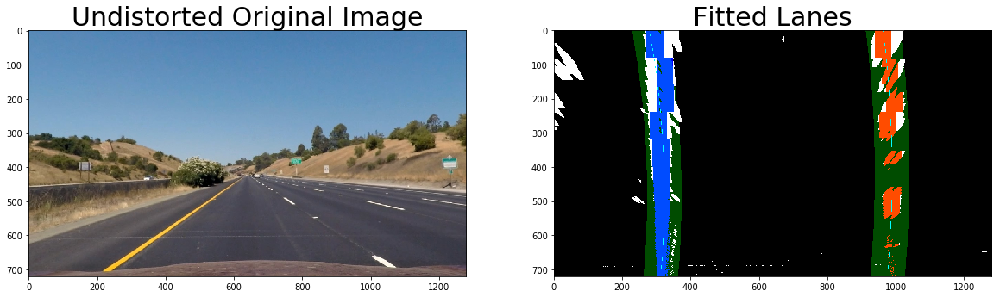

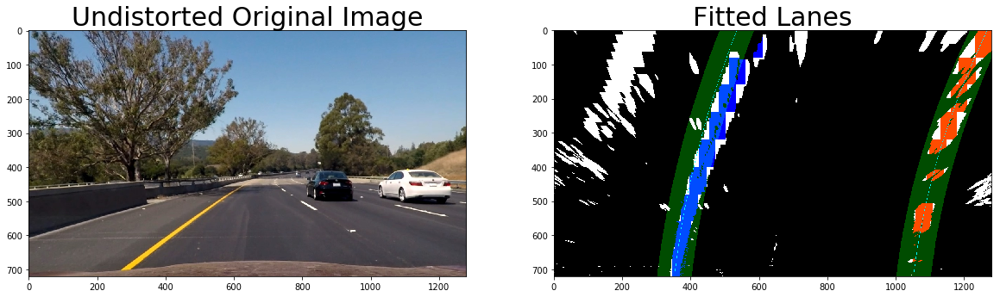

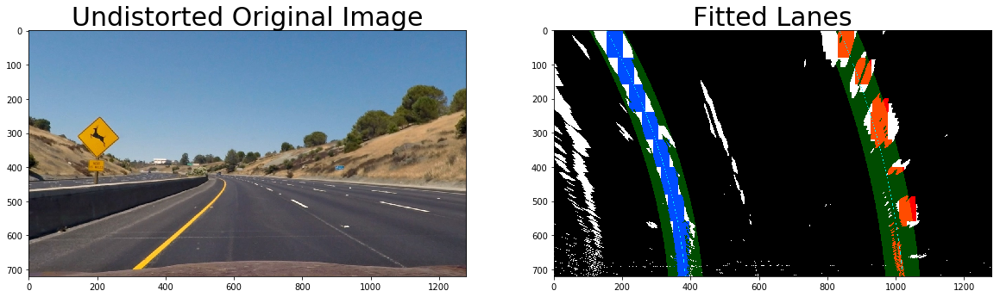

In [11]:
outfile = '../../Projects/Project_04/output_images/lines_perspective/lines_perspective_{0}'
for l in lanes_list:
    l.fit_lines(mtx, dist, M, margin_naive, margin_prior, window_width, window_height, minsum, d=2)
    l.plot_lines_perspective(mtx, dist, M, margin_naive, outfile=outfile.format(os.path.basename(l.imgpath)))

## 6. Determine the curvature of the lane and vehicle position with respect to center.

See Section 8.

## 7. Warp the detected lane boundaries back onto the original image.

See Section 8.

## 8. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

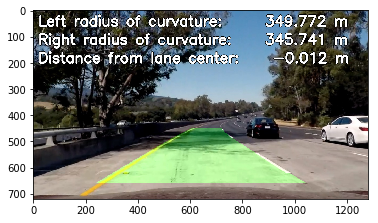

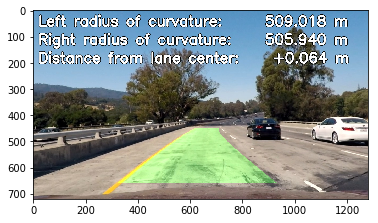

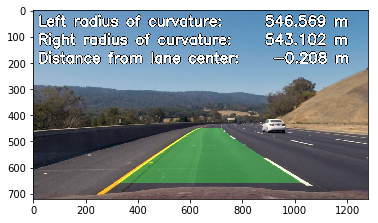

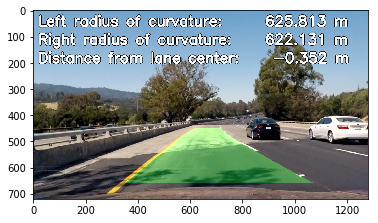

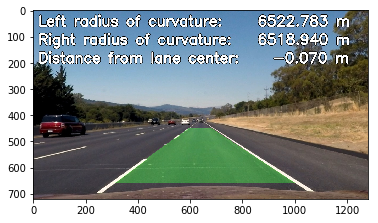

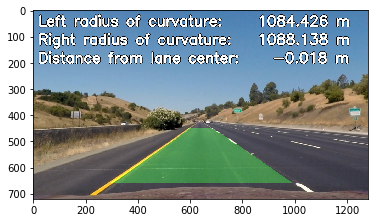

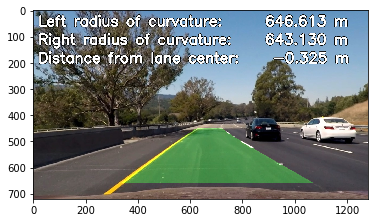

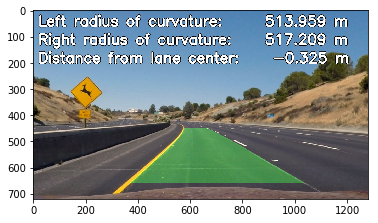

In [12]:
outfile = '../../Projects/Project_04/output_images/lines/lines_{0}'
for l in lanes_list:
    l.plot_lines(mtx, dist, M, Minv, show_plot=True, outfile=outfile.format(os.path.basename(l.imgpath)))

## Process a video

### Load the frames

In [13]:
clip = '../../Repos/CarND-Advanced-Lane-Lines/project_video.mp4'

# use the previous `n` frames to help detect the lane
n = 3

# https://tobilehman.com/blog/2013/01/20/extract-array-of-frames-from-mp4-using-python-opencv-bindings/
vidcap = cv2.VideoCapture(clip)
count = 0
lanes_list = []
success = True

while success:
    success, img = vidcap.read()
    
    if success:    
        l = Lane(img)
        if count > 0:
            l.prev = lanes_list[max(count-n, 0):count][::-1]

        lanes_list.append(l)
        
    if cv2.waitKey(10) == 27:                     # exit if Escape is hit
        break
    count += 1

### Fit the lane lines

In [14]:
for l in lanes_list:
    l.fit_lines(mtx, dist, M, margin_naive, margin_prior, window_width, window_height, minsum, d=2)

### Output a video

In [15]:
# http://tsaith.github.io/combine-images-into-a-video-with-python-3-and-opencv-3.html

output = '../../Projects/Project_04/project_video_lanes.mp4'

# Determine the width and height from the first image
height, width, channels = lanes_list[0].img.shape

# Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'mp4v') # Be sure to use lower case
out = cv2.VideoWriter(output, fourcc, 20.0, (width, height))

for l in lanes_list:
    frame = l.plot_lines(mtx, dist, M, Minv)
    out.write(frame)

    cv2.imshow('video',frame)
    if (cv2.waitKey(1) & 0xFF) == ord('q'): # Hit `q` to exit
        break

# Release everything if job is finished
out.release()
cv2.destroyAllWindows()